In [1]:
import tensorflow as tf
tf.config.experimental.list_physical_devices()

2024-03-28 15:36:28.559023: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-28 15:36:28.559119: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-28 15:36:28.698201: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [2]:
import os

os.environ["TF_CPP_MIN_LOG_LEVEL"] = "2"

import argparse
import pandas as pd
import xml.etree.ElementTree as ET
import matplotlib.pyplot as plt 
import matplotlib.patches as patches

import numpy as np
import cv2
from glob import glob
from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger, ReduceLROnPlateau, EarlyStopping, TensorBoard
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy, SparseCategoricalCrossentropy,CategoricalCrossentropy
from sklearn.preprocessing import LabelEncoder

from tqdm import tqdm
from sklearn.metrics import accuracy_score
from tensorflow.keras.models import load_model, Model
# from tensorflow.keras import models
from tensorflow.keras.layers import *


def xml_to_csv(path):
    xml_list = []
    for file in os.scandir(path):
        if file.is_file() and file.name.endswith(('.xml')):
            xml_file = os.path.join(path, file.name)
            tree = ET.parse(xml_file)
            root = tree.getroot()
            for member in root.findall('object'):
                value = (root.find('filename').text,
                        int(root.find('size')[0].text),
                        int(root.find('size')[1].text),
                        member[0].text,
                        int(member[5][0].text),
                        int(member[5][1].text),
                        int(member[5][2].text),
                        int(member[5][3].text) )
                xml_list.append(value)

    column_name = ['filename', 'width', 'height', 'class', 'xmin', 'xmax', 'ymin', 'ymax']
    xml_df = pd.DataFrame(xml_list, columns=column_name)
    return xml_df


if __name__ == "__main__":
    path_train = '/kaggle/input/custom-dataset-new/train'
    path_valid = '/kaggle/input/custom-dataset-new/valid'
    path_test = '/kaggle/input/custom-dataset-new/test'
    
    train = xml_to_csv(path_train)
    valid = xml_to_csv(path_valid)
    test = xml_to_csv(path_test)
    
    print('Successfully converted xml to csv.')

Successfully converted xml to csv.


In [3]:
train.head()

,filename,width,height,class,xmin,xmax,ymin,ymax
0,GS248FG016GD_jpg.rf.79d5c9febe9dbf53a80a242b44...,640,640,Desk,5,634,4,630
1,tai-xuong-11-_jpg.rf.170b18919d8c5c4b34f83549e...,640,640,Laptop,11,637,94,545
2,00000716_jpg.rf.424d152f86780ae29d3d49b1e70b15...,640,640,Chair,6,565,25,581
3,1645735679908_jpeg.rf.8e4243c63c7efb50b1092b72...,640,640,Chair,144,457,122,627
4,1645732513953_jpeg.rf.f6a9fba7b05f0ec44937a0ca...,640,640,Chair,156,458,35,619


In [4]:
label_encoder = LabelEncoder()
original_values = train['class'].unique()

train['class_encoded'] = label_encoder.fit_transform(train['class'])
valid['class_encoded'] = label_encoder.fit_transform(valid['class'])
test['class_encoded'] = label_encoder.fit_transform(test['class'])

In [5]:
pre_dict = train[['class', 'class_encoded']].drop_duplicates()
class_dict= pd.Series(pre_dict.class_encoded.values, index=pre_dict['class']).to_dict()
class_dict = sorted(class_dict.items(), key=lambda x:x[1])
class_dict = dict(class_dict)
class_dict

{'Chair': 0, 'Desk': 1, 'Laptop': 2, 'person': 3}

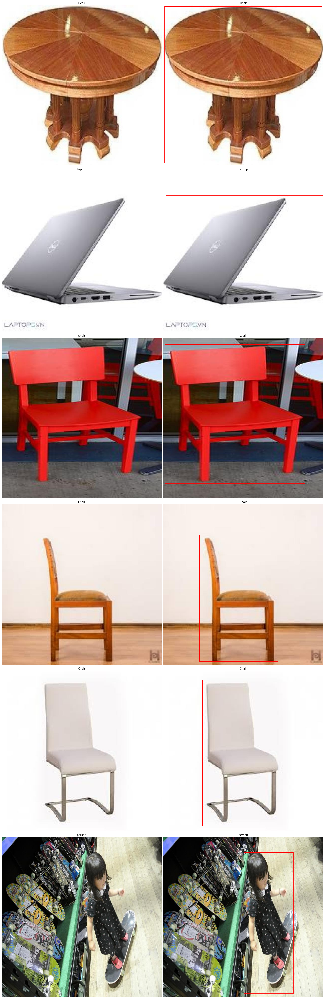

In [6]:
def ShowImage(data, path, number=None):
    fig, axes = plt.subplots(number, 2, figsize=(20, 60))
    for i in range(number):  
        img = plt.imread(os.path.join(path, data['filename'][i]))
        x, y, width, height  = data['xmin'][i], data['ymin'][i], data['xmax'][i]-data['xmin'][i], data['ymax'][i]-data['ymin'][i]
        rect = patches.Rectangle((x, y),
                             width, height,
                             linewidth = 2,
                             edgecolor = 'r',
                             facecolor = 'none')
        axes[i, 0].imshow(img)
        axes[i, 1].imshow(img)
        axes[i, 1].add_patch(rect)
        axes[i, 0].set_title(train['class'][i])
        axes[i, 1].set_title(train['class'][i])
        axes[i, 0].axis("off")
        axes[i, 1].axis("off")
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    ShowImage(train , path_train, number=6) 

In [7]:
global height
global width
global num_classes
global AUTOTUNE

def load_labels(data):
    names = data['class'].unique().tolist()
    return names

def load_data(path, data, classes, p_data=None):
    images = []
    bboxes = []
    labels = []
    
    
    for index, row in data.iterrows():
        name = row['filename']
        x1 = int(row['xmin'])
        y1 = int(row['ymin'])
        x2 = int(row['xmax'])
        y2 = int(row['ymax'])
        label = int(row['class_encoded'])
        
        if p_data == 'train':
            image = os.path.join(path, "train", name)
        elif p_data == 'valid':
            image = os.path.join(path, "valid" , name)
        else:
            image = os.path.join(path, "test" , name)

        bbox = [x1, y1, x2, y2]

        images.append(image)
        bboxes.append(bbox)
        labels.append(label)

    return images, bboxes, labels

def read_image_bbox(path, bbox, label_index):
    path = path.decode()
    image = cv2.imread(path, cv2.IMREAD_COLOR)
    h, w, _ = image.shape
    image = cv2.resize(image, (width, height))
    image = (image - 127.5) / 127.5 ## [-1, +1]
    image = image.astype(np.float32)

    x1, y1, x2, y2 = bbox

    norm_x1 = float(x1/w)
    norm_y1 = float(y1/h)
    norm_x2 = float(x2/w)
    norm_y2 = float(y2/h)
    norm_bbox = np.array([norm_x1, norm_y1, norm_x2, norm_y2], dtype=np.float32)

    label = [0] * num_classes
    label[label_index] = 1 #Fix here
    class_label = np.array(label, dtype=np.float32)

    return image, norm_bbox, class_label

def parse(image, bbox, label):
    image, bbox, label = tf.numpy_function(read_image_bbox, [image, bbox, label], [tf.float32, tf.float32, tf.float32])
    image.set_shape((height, width, 3))
    bbox.set_shape((4))
    label.set_shape((num_classes))
    return (image), (bbox, label)

def tf_dataset(images, bboxes, labels, batch_size, shuffle=False):
    ds = tf.data.Dataset.from_tensor_slices((images, bboxes, labels))
    ds = ds.map(parse, num_parallel_calls=AUTOTUNE)
    if shuffle:
        ds = ds.cache().shuffle(1000).batch(batch_size).prefetch(buffer_size=AUTOTUNE)
    else:
        ds = ds.cache().batch(batch_size).prefetch(buffer_size=AUTOTUNE)   
    return ds

def load_dataset(path, data_type, classes):
    
    train, valid, test = data_type[0], data_type[1], data_type[2]
    
    train_images, train_bboxes, train_labels = load_data(path, train, classes, 'train')
    
    valid_images, valid_bboxes, valid_labels = load_data(path, valid, classes, 'valid')
    
    test_images, test_bboxes, test_labels = load_data(path, test, classes, 'test')

    return (train_images, train_bboxes, train_labels), (valid_images, valid_bboxes, valid_labels), (test_images, test_bboxes, test_labels)

if __name__ == "__main__":

    height = 320
    width = 320
    batch_size = 32
    AUTOTUNE = tf.data.AUTOTUNE
    
    data_type = [train, valid, test]
    path = '/kaggle/input/custom-dataset-new'
    
    classes = load_labels(train)
    num_classes = len(classes)
    
    (train_images, train_bboxes, train_labels), (valid_images, valid_bboxes, valid_labels), (test_images, test_bboxes, test_labels) = load_dataset(path, data_type, classes)
    print(f"Classes: {classes}")
    print(f"Total class : {num_classes}")
    print(f"Train: {len(train_images)} - {len(train_bboxes)} - {len(train_labels)}")
    print(f"Valid: {len(valid_images)} - {len(valid_bboxes)} - {len(valid_labels)}")
    print(f"Test : {len(test_images)} - {len(test_bboxes)} - {len(test_labels)}")

Train: 2829 - 2829 - 2829
Valid: 738 - 738 - 738
Test : 439 - 439 - 439


In [8]:
train_ds = tf_dataset(train_images, train_bboxes, train_labels, batch_size, shuffle=True)
valid_ds = tf_dataset(valid_images, valid_bboxes, valid_labels, batch_size )

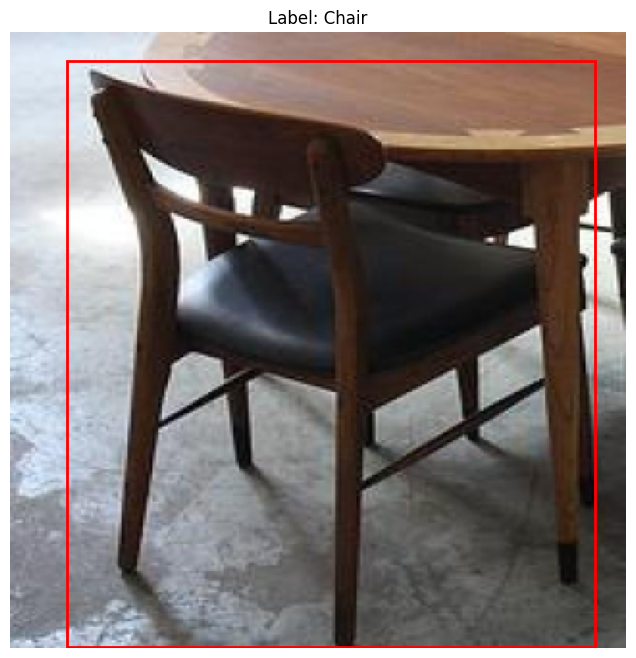

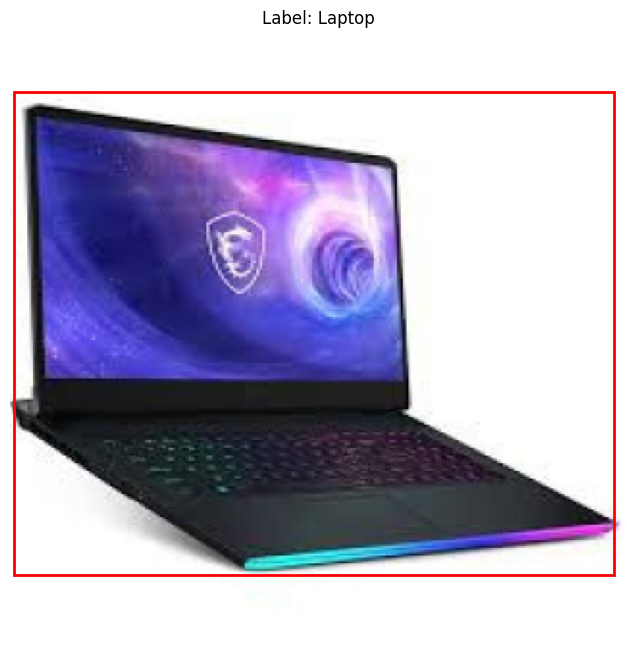

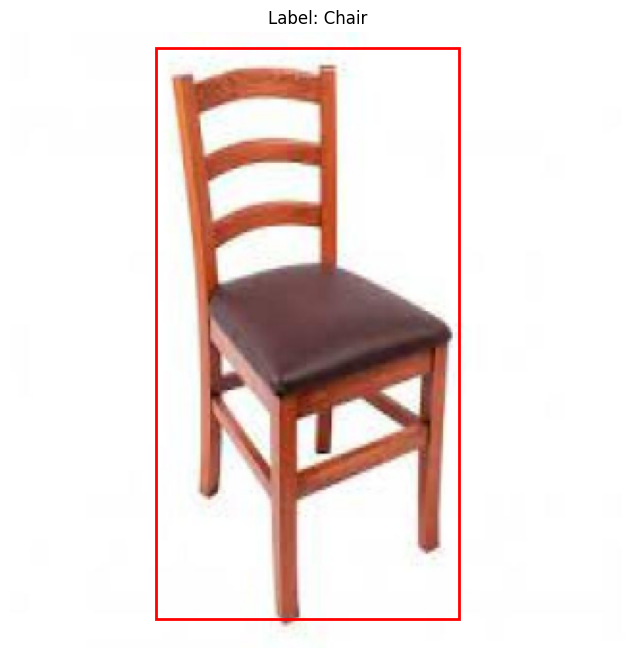

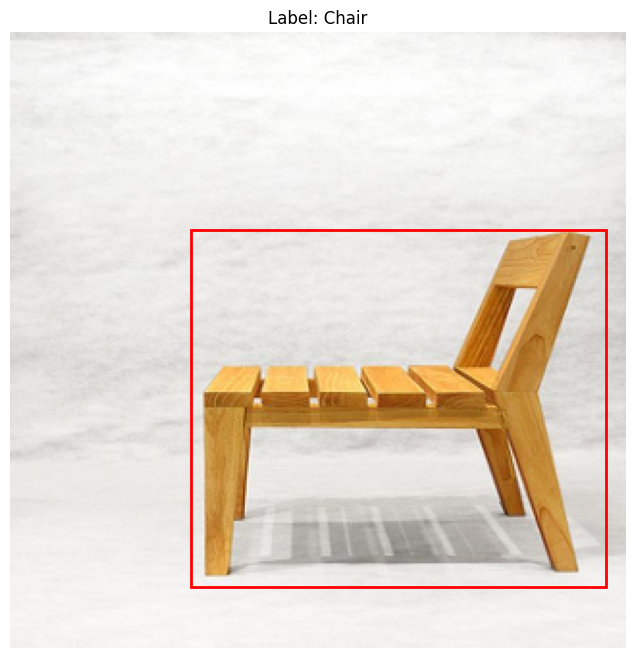

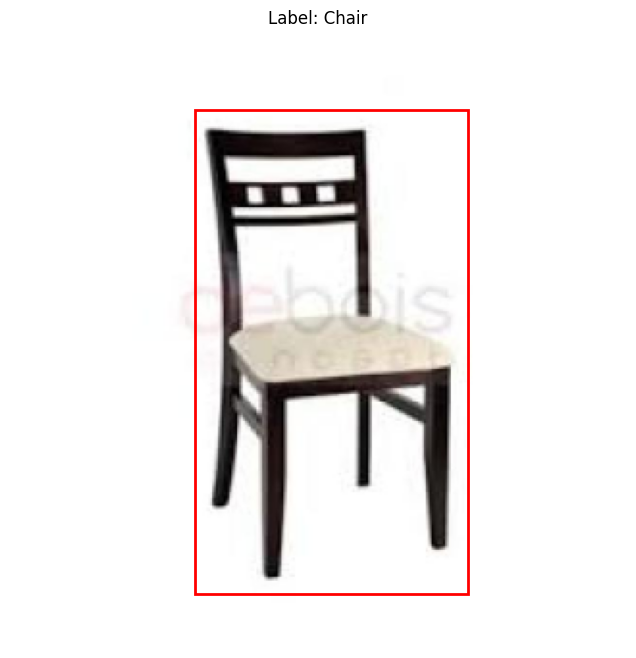

...

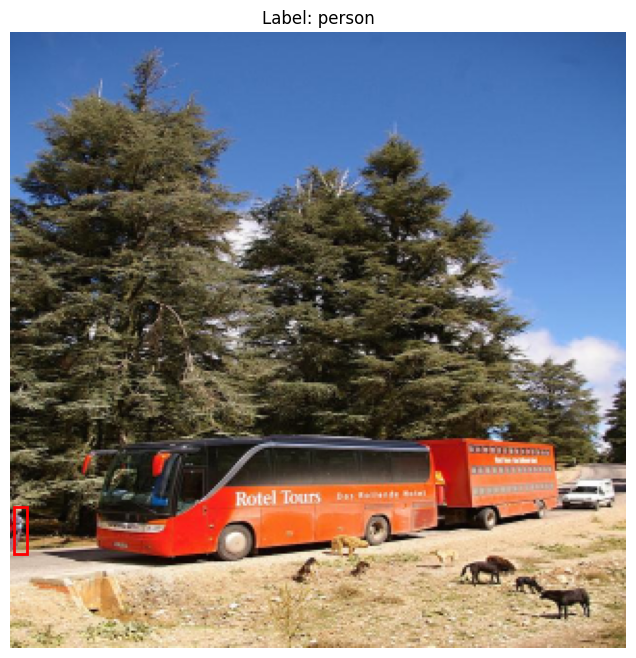

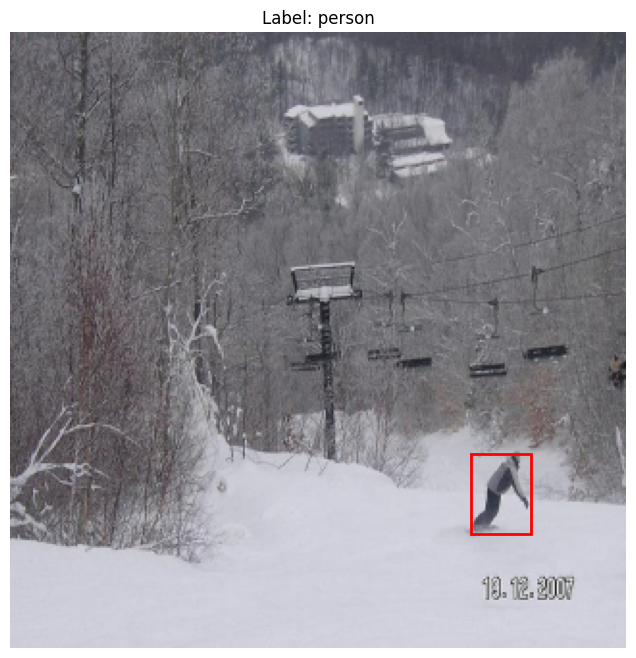

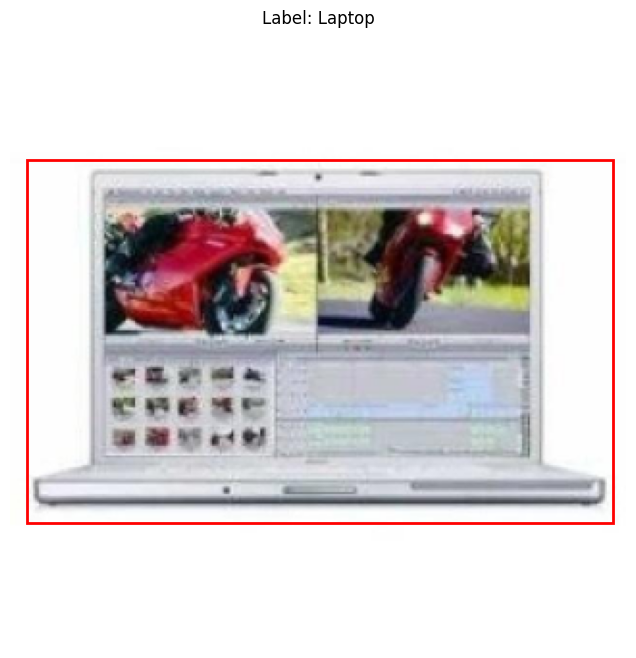

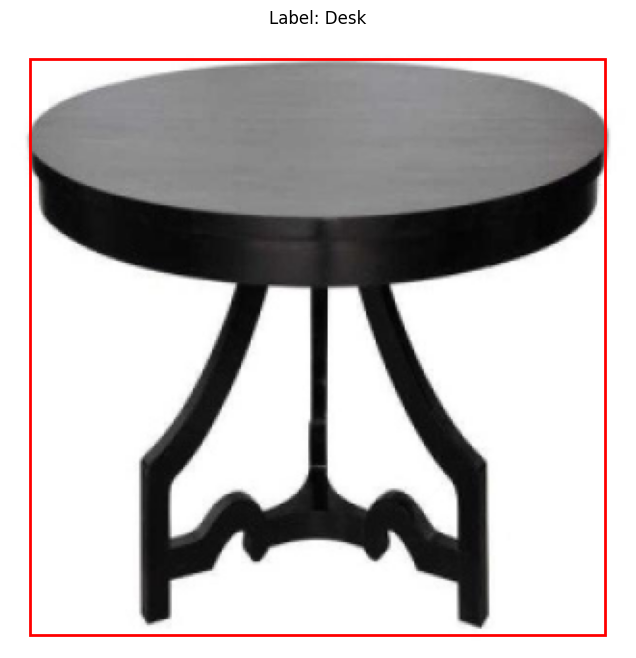

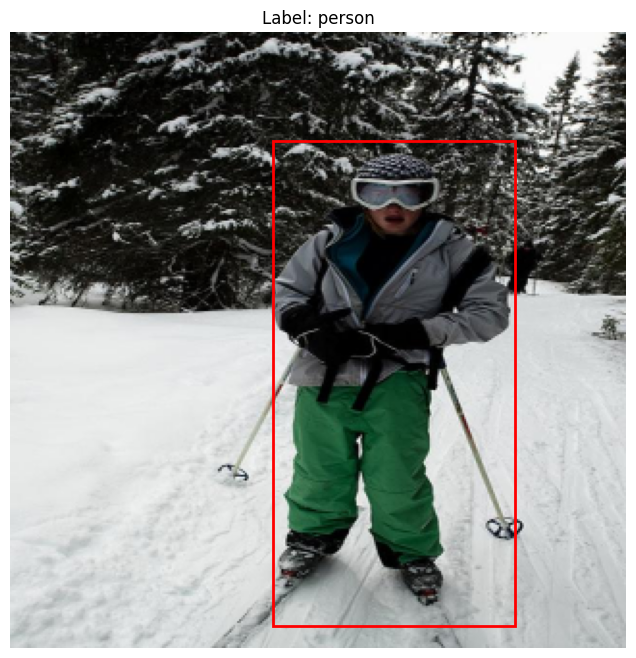

In [10]:
for batch in train_ds.take(1):  
    (images) ,(bboxes, labels) = batch
    for i in range(len(images)): 
        image = images[i].numpy()  
        image = (image * 127.5 + 127.5).astype('uint8')  
        bbox = bboxes[i].numpy()  
        label = labels[i].numpy() 
        plt.figure(figsize=(8, 8))
        plt.imshow(image[...,::-1])
        h, w, _ = image.shape
        x1, y1, x2, y2 = bbox * [w, h, w, h]  
        plt.gca().add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='red', facecolor='none'))
        class_id = label.argmax()
        text = [i for i in class_dict if class_dict[i]== int(class_id)]
        plt.title(f"Label: {text[0]}")
        plt.axis('off')
        plt.show()

In [ ]:
# class Mobilenet_V2():
#     def __init__(self, *, inp_shape = (320,320,3), rho = 1.0 , alpha = 1.0, expansion = 6.0, classes = 2, droppout = 0.0):
#         assert alpha > 0 and alpha <= 1 ,'Error, my Mobilenet_V2 can only accept  alpha > 0 and alpha <= 1'
#         assert rho > 0 and rho <= 1 ,'Error, my Mobilenet_V2 can only accept  rho > 0 and rho <= 1'
#         self._inp_shape = inp_shape
#         self._rho = rho
#         self._alpha = alpha
#         self._expansion = expansion
#         self._classes = classes
#         self._droppout = droppout
#     def _depthwiseconv(self, *, strides: int):
#         return models.Sequential([
#             DepthwiseConv2D(kernel_size= (3,3), strides= strides, padding= 'same' if strides == 1 else 'valid', use_bias= False),
#             BatchNormalization(),
#             ReLU(max_value= 6.)
#         ])
#     def _pointwiseconv(self, *, filters: int, linear: bool):
#         layer = models.Sequential([
#             Conv2D(filters= int(filters * self._alpha), kernel_size= (1,1), strides= (1,1), padding= 'same', use_bias= False),
#             BatchNormalization(),
#         ])
#         if linear == False:
#             layer.add(ReLU(max_value= 6.))
#         return layer
#     def _standardconv(self):
#         return models.Sequential([
#             Conv2D(filters= 32, kernel_size= (3,3), strides= (2,2), use_bias= False),
#             BatchNormalization(),
#             ReLU(max_value= 6.)
#         ])
#     def _inverted_residual_block_(self, x, *, strides_depthwise: int, filter_pointwise: int, expansion: int):
#         filter = int(filter_pointwise * self._alpha)
#         fx = self._pointwiseconv(filters= filter * expansion, linear= False)(x)
#         fx = self._depthwiseconv(strides= strides_depthwise)(fx)
#         fx = self._pointwiseconv(filters= filter , linear= True)(fx)
#         if strides_depthwise == 1 and x.shape[-1] == filter_pointwise:
#             return add([fx,x])
#         else:
#             return fx
#     def _bottleneck_block_(self, x, *,  s: int, c: int, t: int, n: int):
#         x = self._inverted_residual_block_(x, strides_depthwise= s, filter_pointwise= c, expansion= t)
#         for i in range(n-1):
#             x = self._inverted_residual_block_(x, strides_depthwise= 1, filter_pointwise= c, expansion= t)
#         return x 
#     def build(self):
#         print("Loading model Mobilenetv2...")
#         feature_map = int(self._rho * self._inp_shape[0])
#         img_inp = Input(shape= (feature_map, feature_map,3))
#         x = self._standardconv()(img_inp)
#         x = self._bottleneck_block_(x, s= 1, c= 16, t= 1, n= 1)
#         x = self._bottleneck_block_(x, s= 2, c= 24, t= self._expansion, n= 2)
#         x = self._bottleneck_block_(x, s= 2, c= 32, t= self._expansion, n= 3)
#         x = self._bottleneck_block_(x, s= 2, c= 64, t= self._expansion, n= 4)
#         x = self._bottleneck_block_(x, s= 1, c= 96, t= self._expansion, n= 3)
#         x = self._bottleneck_block_(x, s= 2, c= 160, t= self._expansion, n= 3)
#         x = self._bottleneck_block_(x, s= 1, c= 320, t= self._expansion, n= 1)
#         x = self._pointwiseconv(filters= 1280, linear= False)(x)
#         x = GlobalAveragePooling2D()(x)
#         x = Dropout(self._droppout)(x)
        
#         bbox = Dense(4, activation="sigmoid", name="bbox")(x)
#         label = Dense(self._classes, activation='softmax', name="label")(x)
        
#         print("Success")
        
#         return models.Model(img_inp, outputs=[bbox, label])


In [ ]:
# model = Mobilenet_V2(inp_shape=(height,width,3), rho=1.0, alpha=1.0, expansion=6.0, classes=2, droppout=0.5).build()

In [11]:
def InceptionV3():
    input_layer = Input(shape=(320 , 320 , 3))
    
    x = StemBlock(input_layer)
    
    x = InceptionBlock_A(prev_layer = x ,nbr_kernels = 32)
    x = InceptionBlock_A(prev_layer = x ,nbr_kernels = 64)
    x = InceptionBlock_A(prev_layer = x ,nbr_kernels = 64)
    
    x = ReductionBlock_A(prev_layer = x )
    
    x = InceptionBlock_B(prev_layer = x  , nbr_kernels = 128)
    x = InceptionBlock_B(prev_layer = x , nbr_kernels = 160)
    x = InceptionBlock_B(prev_layer = x , nbr_kernels = 160)
    x = InceptionBlock_B(prev_layer = x , nbr_kernels = 192)
    
#     Aux = auxiliary_classifier(prev_Layer = x)
    
    x = ReductionBlock_B(prev_layer = x)
    
    x = InceptionBlock_C(prev_layer = x)
    x = InceptionBlock_C(prev_layer = x)
    
    x = GlobalAveragePooling2D()(x)
    x = Dense(units=2048, activation='relu') (x)
    x = Dropout(rate = 0.2) (x)
    
    bbox = Dense(4, activation="sigmoid", name="bbox")(x)
    label = Dense(4, activation='softmax', name="label")(x)
    
    
    model = Model(inputs = input_layer , outputs = [bbox , label] , name = 'Inception-V3')
    
    return model


def conv_with_Batch_Normalisation(prev_layer , nbr_kernels , filter_Size , strides =(1,1) , padding = 'same'):
    x = Conv2D(filters=nbr_kernels, kernel_size = filter_Size, strides=strides , padding=padding)(prev_layer)
    x = BatchNormalization(axis=3)(x)
    x = Activation(activation='relu')(x)
    return x


def StemBlock(prev_layer):
    x = conv_with_Batch_Normalisation(prev_layer, nbr_kernels = 32, filter_Size=(3,3) , strides=(2,2))
    x = conv_with_Batch_Normalisation(x, nbr_kernels = 32, filter_Size=(3,3))
    x = conv_with_Batch_Normalisation(x, nbr_kernels = 64, filter_Size=(3,3))
    x = MaxPool2D(pool_size=(3,3) , strides=(2,2)) (x)
    x = conv_with_Batch_Normalisation(x, nbr_kernels = 80, filter_Size=(1,1))
    x = conv_with_Batch_Normalisation(x, nbr_kernels = 192, filter_Size=(3,3))
    x = MaxPool2D(pool_size=(3,3) , strides=(2,2)) (x)
    return x    
    

def InceptionBlock_A(prev_layer  , nbr_kernels):
    
    branch1 = conv_with_Batch_Normalisation(prev_layer, nbr_kernels = 64, filter_Size = (1,1))
    branch1 = conv_with_Batch_Normalisation(branch1, nbr_kernels=96, filter_Size=(3,3))
    branch1 = conv_with_Batch_Normalisation(branch1, nbr_kernels=96, filter_Size=(3,3))
    
    branch2 = conv_with_Batch_Normalisation(prev_layer, nbr_kernels=48, filter_Size=(1,1))
    branch2 = conv_with_Batch_Normalisation(branch2, nbr_kernels=64, filter_Size=(3,3)) # may be 3*3
    
    branch3 = AveragePooling2D(pool_size=(3,3) , strides=(1,1) , padding='same') (prev_layer)
    branch3 = conv_with_Batch_Normalisation(branch3, nbr_kernels = nbr_kernels, filter_Size = (1,1))
    
    branch4 = conv_with_Batch_Normalisation(prev_layer, nbr_kernels=64, filter_Size=(1,1))
    
    output = concatenate([branch1 , branch2 , branch3 , branch4], axis=3)
    
    return output


def InceptionBlock_B(prev_layer , nbr_kernels):
    
    branch1 = conv_with_Batch_Normalisation(prev_layer, nbr_kernels = nbr_kernels, filter_Size = (1,1))
    branch1 = conv_with_Batch_Normalisation(branch1, nbr_kernels = nbr_kernels, filter_Size = (7,1))
    branch1 = conv_with_Batch_Normalisation(branch1, nbr_kernels = nbr_kernels, filter_Size = (1,7))
    branch1 = conv_with_Batch_Normalisation(branch1, nbr_kernels = nbr_kernels, filter_Size = (7,1))    
    branch1 = conv_with_Batch_Normalisation(branch1, nbr_kernels = 192, filter_Size = (1,7))
    
    branch2 = conv_with_Batch_Normalisation(prev_layer, nbr_kernels = nbr_kernels, filter_Size = (1,1))
    branch2 = conv_with_Batch_Normalisation(branch2, nbr_kernels = nbr_kernels, filter_Size = (1,7))
    branch2 = conv_with_Batch_Normalisation(branch2, nbr_kernels = 192, filter_Size = (7,1))
    
    branch3 = AveragePooling2D(pool_size=(3,3) , strides=(1,1) , padding ='same') (prev_layer)
    branch3 = conv_with_Batch_Normalisation(branch3, nbr_kernels = 192, filter_Size = (1,1))
    
    branch4 = conv_with_Batch_Normalisation(prev_layer, nbr_kernels = 192, filter_Size = (1,1))
    
    output = concatenate([branch1 , branch2 , branch3 , branch4], axis = 3)
    
    return output    

    
def InceptionBlock_C(prev_layer):
    
    branch1 = conv_with_Batch_Normalisation(prev_layer, nbr_kernels = 448, filter_Size = (1,1))
    branch1 = conv_with_Batch_Normalisation(branch1, nbr_kernels = 384, filter_Size = (3,3))
    branch1_1 = conv_with_Batch_Normalisation(branch1, nbr_kernels = 384, filter_Size = (1,3))    
    branch1_2 = conv_with_Batch_Normalisation(branch1, nbr_kernels = 384, filter_Size = (3,1))
    branch1 = concatenate([branch1_1 , branch1_2], axis = 3)
    
    branch2 = conv_with_Batch_Normalisation(prev_layer, nbr_kernels = 384, filter_Size = (1,1))
    branch2_1 = conv_with_Batch_Normalisation(branch2, nbr_kernels = 384, filter_Size = (1,3))
    branch2_2 = conv_with_Batch_Normalisation(branch2, nbr_kernels = 384, filter_Size = (3,1))
    branch2 = concatenate([branch2_1 , branch2_2], axis = 3)
    
    branch3 = AveragePooling2D(pool_size=(3,3) , strides=(1,1) , padding='same')(prev_layer)
    branch3 = conv_with_Batch_Normalisation(branch3, nbr_kernels = 192, filter_Size = (1,1))
    
    branch4 = conv_with_Batch_Normalisation(prev_layer, nbr_kernels = 320, filter_Size = (1,1))
    
    output = concatenate([branch1 , branch2 , branch3 , branch4], axis = 3)
    
    return output


def ReductionBlock_A(prev_layer):
    
    branch1 = conv_with_Batch_Normalisation(prev_layer, nbr_kernels = 64, filter_Size = (1,1))
    branch1 = conv_with_Batch_Normalisation(branch1, nbr_kernels = 96, filter_Size = (3,3))
    branch1 = conv_with_Batch_Normalisation(branch1, nbr_kernels = 96, filter_Size = (3,3) , strides=(2,2) ) #, padding='valid'
    
    branch2 = conv_with_Batch_Normalisation(prev_layer, nbr_kernels = 384, filter_Size=(3,3) , strides=(2,2) )
    
    branch3 = MaxPool2D(pool_size=(3,3) , strides=(2,2) , padding='same')(prev_layer)
    
    output = concatenate([branch1 , branch2 , branch3], axis = 3)
    
    return output


def ReductionBlock_B(prev_layer):
    
    branch1 = conv_with_Batch_Normalisation(prev_layer, nbr_kernels = 192, filter_Size = (1,1))
    branch1 = conv_with_Batch_Normalisation(branch1, nbr_kernels = 192, filter_Size = (1,7))
    branch1 = conv_with_Batch_Normalisation(branch1, nbr_kernels = 192, filter_Size = (7,1))
    branch1 = conv_with_Batch_Normalisation(branch1, nbr_kernels = 192, filter_Size = (3,3) , strides=(2,2) , padding = 'valid')
    
    branch2 = conv_with_Batch_Normalisation(prev_layer, nbr_kernels = 192, filter_Size = (1,1) )
    branch2 = conv_with_Batch_Normalisation(branch2, nbr_kernels = 320, filter_Size = (3,3) , strides=(2,2) , padding='valid' )

    branch3 = MaxPool2D(pool_size=(3,3) , strides=(2,2) )(prev_layer)
    
    output = concatenate([branch1 , branch2 , branch3], axis = 3)
    
    return output


def auxiliary_classifier(prev_Layer):
    x = AveragePooling2D(pool_size=(5,5) , strides=(3,3)) (prev_Layer)
    x = conv_with_Batch_Normalisation(x, nbr_kernels = 128, filter_Size = (1,1))
    x = Flatten()(x)
    x = Dense(units = 768, activation='relu') (x)
    x = Dropout(rate = 0.2) (x)
    x = Dense(units = 4, activation='softmax') (x)
    return x

In [12]:
model = InceptionV3()

In [13]:
model.summary()

Model: "Inception-V3"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 320, 320,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 160, 160,  │        896 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 160, 160,  │        128 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 160, 160,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 160, 160,  │      9,248 │ activation[0][0]  │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 160, 160,  │        128 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, 160, 160,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 160, 160,  │     18,496 │ activation_1[0][… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 160, 160,  │        256 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, 160, 160,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 79, 79,    │          0 │ activation_2[0][… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 79, 79,    │      5,200 │ max_pooling2d[0]… │
│                     │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 79, 79,    │        320 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, 79, 79,    │          0 │ batch_normalizat… │
│ (Activation)        │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 79, 79,    │    138,432 │ activation_3[0][… │
│                     │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 79, 79,    │        768 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_4        │ (None, 79, 79,    │          0 │ batch_normalizat

 Total params: 25,902,504 (98.81 MB)

 Trainable params: 25,868,072 (98.68 MB)

 Non-trainable params: 34,432 (134.50 KB)

In [20]:
import math

def ciou_loss(target,  output):
    
    target = target * tf.cast(target != 0, tf.float32)
    output = output * tf.cast(target != 0, tf.float32)

    x1g, y1g, x2g, y2g = tf.split(value=target, num_or_size_splits=4, axis=1)
    x1, y1, x2, y2 = tf.split(value=output, num_or_size_splits=4, axis=1)
    
    w_pred = x2 - x1
    h_pred = y2 - y1
    w_gt = x2g - x1g
    h_gt = y2g - y1g

    x_center = (x2 + x1) / 2
    y_center = (y2 + y1) / 2
    x_center_g = (x1g + x2g) / 2
    y_center_g = (y1g + y2g) / 2

    xc1 = tf.minimum(x1, x1g)
    yc1 = tf.minimum(y1, y1g)
    xc2 = tf.maximum(x2, x2g)
    yc2 = tf.maximum(y2, y2g)
    
    ###iou term###
    xA = tf.maximum(x1g, x1)
    yA = tf.maximum(y1g, y1)
    xB = tf.minimum(x2g, x2)
    yB = tf.minimum(y2g, y2)

    interArea = tf.maximum(0.0, (xB - xA + 1)) * tf.maximum(0.0, yB - yA + 1)

    boxAArea = (x2g - x1g +1) * (y2g - y1g +1)
    boxBArea = (x2 - x1 +1) * (y2 - y1 +1)

    iouk = interArea / (boxAArea + boxBArea - interArea + 1e-10)
    ###
    
    ###distance term###
    c = ((xc2 - xc1) ** 2) + ((yc2 - yc1) ** 2) +1e-7
    d = ((x_center - x_center_g) ** 2) + ((y_center - y_center_g) ** 2)
    u = d / c
    ###

    ###aspect-ratio term###
    arctan = tf.atan(w_gt/(h_gt + 1e-10))-tf.atan(w_pred/(h_pred + 1e-10))
    v = (4 / (math.pi ** 2)) * tf.pow((tf.atan(w_gt/(h_gt + 1e-10))-tf.atan(w_pred/(h_pred + 1e-10))),2)
    S = 1 - iouk
    alpha = v / (S + v + 1e-10)
    w_temp = 2 * w_pred
    ar = (8 / (math.pi ** 2)) * arctan * ((w_pred - w_temp) * h_pred)
    ###
    
    ###calculate ciou###
    ciouk = iouk - (u + alpha * ar)
    ciouk = (1 - ciouk)
    ###
    
    return ciouk

In [21]:
lr = 1e-4  
num_epochs = 200

model.compile(
    loss = {
#         "bbox": BinaryCrossentropy(from_logits=False),
        "bbox": ciou_loss,
        "label": CategoricalCrossentropy(from_logits=False) ,
    },
    optimizer=Adam(lr),
    metrics={
        "bbox": ['acc'], 
        "label": ['acc'] 
    }
)

callbacks = [
    ModelCheckpoint('best_model.keras', verbose=1, save_best_only=True),
    ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=20, min_lr=1e-6, verbose=1),
    CSVLogger('log.csv', append=True),
    EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=False, verbose=1),
]

history= model.fit(
    train_ds,
    epochs=num_epochs,
    validation_data=valid_ds,
    callbacks=callbacks
)
model.save('final_model.keras')

Epoch 1/200


2024-03-28 15:53:48.559097: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[192,80,3,3]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,80,79,79]{3,2,1,0}, f32[32,192,79,79]{3,2,1,0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-03-28 15:53:48.618154: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.059167607s
Trying algorithm eng0{} for conv (f32[192,80,3,3]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,80,79,79]{3,2,1,0}, f32[32,192,79,79]{3,2,1,0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-03-28 15:53:50.046463: E external/loca

89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - bbox_acc: 0.6019 - label_acc: 0.5656 - loss: 1.3397   
Epoch 1: val_loss improved from inf to 2.42937, saving model to best_model.keras
89/89 ━━━━━━━━━━━━━━━━━━━━ 252s 1s/step - bbox_acc: 0.6025 - label_acc: 0.5666 - loss: 1.3371 - val_bbox_acc: 0.6260 - val_label_acc: 0.2791 - val_loss: 2.4294 - learning_rate: 1.0000e-04
Epoch 2/200
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step - bbox_acc: 0.7079 - label_acc: 0.7324 - loss: 0.9170
Epoch 2: val_loss improved from 2.42937 to 2.41912, saving model to best_model.keras
89/89 ━━━━━━━━━━━━━━━━━━━━ 30s 338ms/step - bbox_acc: 0.7081 - label_acc: 0.7325 - loss: 0.9167 - val_bbox_acc: 0.6260 - val_label_acc: 0.2791 - val_loss: 2.4191 - learning_rate: 1.0000e-04
Epoch 3/200
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step - bbox_acc: 0.7606 - label_acc: 0.8043 - loss: 0.7370
Epoch 3: val_loss improved from 2.41912 to 1.94757, saving model to best_model.keras
89/89 ━━━━━━━━━━━━━━━━━━━━ 30s 336ms/step - bbox_acc: 0.7606 -

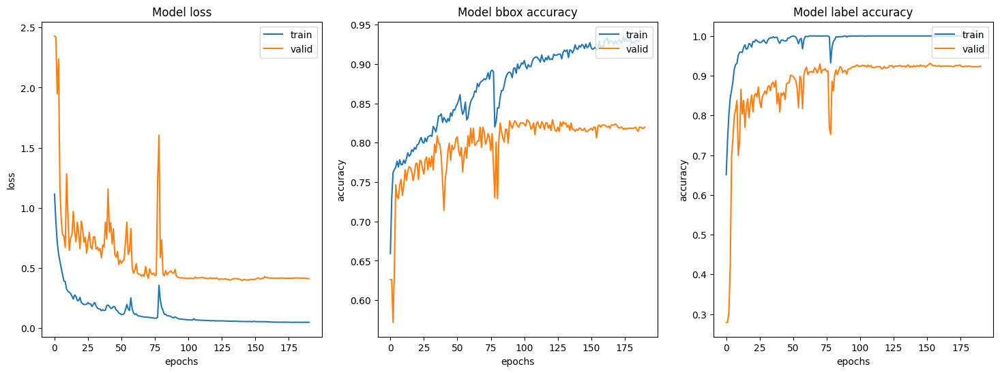

In [24]:
plt.figure(figsize=(18,6))

plt.subplot(1, 3, 1)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epochs')
plt.legend(['train','valid'], loc='upper right')

plt.subplot(1, 3, 2)
plt.title('Model bbox accuracy')
plt.ylabel('accuracy')
plt.xlabel('epochs')
plt.plot(history.history['bbox_acc'])
plt.plot(history.history['val_bbox_acc'])
plt.legend(['train','valid'], loc='upper right')

plt.subplot(1, 3, 3)
plt.title('Model label accuracy')
plt.ylabel('accuracy')
plt.xlabel('epochs')
plt.plot(history.history['label_acc'])
plt.plot(history.history['val_label_acc'])
plt.legend(['train','valid'], loc='upper right')

plt.show()

In [32]:
def cal_iou(y_true, y_pred):
    x1 = max(y_true[0], y_pred[0])
    y1 = max(y_true[1], y_pred[1])
    x2 = min(y_true[2], y_pred[2])
    y2 = min(y_true[3], y_pred[3])

    intersection_area = max(0, x2 - x1 + 1) * max(0, y2 - y1 + 1)

    true_area = (y_true[2] - y_true[0] + 1) * (y_true[3] - y_true[1] + 1)
    bbox_area = (y_pred[2] - y_pred[0] + 1) * (y_pred[3] - y_pred[1] + 1)

    iou = intersection_area / float(true_area + bbox_area - intersection_area)
    return iou

if __name__ == "__main__":
    
    model = tf.keras.models.load_model('/kaggle/working/best_model.keras', custom_objects={"ciou_loss":ciou_loss})

    print(f"Test : {len(test_images)} - {len(test_bboxes)} - {len(test_labels)}")

    mean_iou = []
    pred_labels = []
    images = []

    for image, true_bbox, true_labels in tqdm(zip(test_images, test_bboxes, test_labels), total=len(test_images)):
        name = image.split("/")[-1]

        image = cv2.imread(image, cv2.IMREAD_COLOR)
        x = cv2.resize(image, (width, height))
        x = (x - 127.5) / 127.5
        x = np.expand_dims(x, axis=0)
        
        true_x1, true_y1, true_x2, true_y2 = true_bbox

        pred_bbox, label = model.predict(x, verbose=0)
        pred_bbox = pred_bbox[0]
#         print(pred_bbox)
        label_index = np.argmax(label[0])
        pred_labels.append(label_index)
#         print(label_index)
#         print(true_labels)

        pred_x1 = int(pred_bbox[0] * image.shape[1])
        pred_y1 = int(pred_bbox[1] * image.shape[0])
        pred_x2 = int(pred_bbox[2] * image.shape[1])
        pred_y2 = int(pred_bbox[3] * image.shape[0])

        iou = cal_iou(true_bbox, [pred_x1, pred_y1, pred_x2, pred_y2])
        mean_iou.append(iou)

        image = cv2.rectangle(image, (true_x1, true_y1), (true_x2, true_y2), (255, 0, 0), 2) ## BLUE
        image = cv2.rectangle(image, (pred_x1, pred_y1), (pred_x2, pred_y2), (0, 0, 255), 2) ## RED
        
        font_size = 1.5
        pred_class_name = [i for i in class_dict if class_dict[i]== int(label_index)]
        cv2.putText(image, str(pred_class_name[0]) + ' '+ '(pred)', (80, 300), cv2.FONT_HERSHEY_SIMPLEX, font_size, (0, 0, 255), 2)

        font_size = 1.5
        true_class_name = [i for i in class_dict if class_dict[i]== int(true_labels)]

        cv2.putText(image, str(true_class_name[0])+ ' '+ '(true)', (80, 350), cv2.FONT_HERSHEY_SIMPLEX, font_size, (255, 0, 0), 2)

        font_size = 1.5
        cv2.putText(image, f"IoU: {iou:.4f}", (80, 400), cv2.FONT_HERSHEY_SIMPLEX, font_size, (255, 0, 0), 2)
        images.append(image)

    score = np.mean(mean_iou, axis=0)
    mean_acc = accuracy_score(test_labels, pred_labels)
    print(f"Mean IoU: {score:.4f} - Acc: {mean_acc:.4f}")

Test : 439 - 439 - 439


  1%|          | 3/439 [00:06<12:51,  1.77s/it]

3
3
1
1
0
1


  1%|          | 5/439 [00:06<06:33,  1.10it/s]

3
3
2
2
3
3


  2%|▏         | 9/439 [00:07<02:45,  2.60it/s]

2
2
1
1
0
0


  3%|▎         | 11/439 [00:07<02:01,  3.52it/s]

3
3
3
3
1
1


  3%|▎         | 15/439 [00:07<01:15,  5.59it/s]

2
2
2
2
0
0


  4%|▍         | 17/439 [00:08<01:04,  6.58it/s]

0
0
1
1
1
1


  5%|▍         | 21/439 [00:08<00:49,  8.39it/s]

3
3
3
3
1
1


  5%|▌         | 23/439 [00:08<00:45,  9.14it/s]

2
2
3
3
1
1


  6%|▌         | 27/439 [00:08<00:41,  9.86it/s]

0
0
0
0
1
1


  7%|▋         | 29/439 [00:09<00:40, 10.23it/s]

3
0
3
3
1
1


  8%|▊         | 33/439 [00:09<00:38, 10.50it/s]

0
0
3
2
1
1


  8%|▊         | 35/439 [00:09<00:37, 10.69it/s]

2
0
0
0
0
0


  9%|▉         | 39/439 [00:10<00:36, 10.98it/s]

3
3
3
1
1
1


  9%|▉         | 41/439 [00:10<00:35, 11.06it/s]

2
2
2
2
1
1


 10%|█         | 45/439 [00:10<00:35, 11.13it/s]

3
3
0
0
2
2


 11%|█         | 47/439 [00:10<00:35, 11.12it/s]

0
0
1
1
3
1


 12%|█▏        | 51/439 [00:11<00:35, 11.00it/s]

1
1
1
1
3
3


 12%|█▏        | 53/439 [00:11<00:35, 10.94it/s]

3
3
2
3
1
1


 13%|█▎        | 57/439 [00:11<00:34, 11.07it/s]

0
1
2
2
3
3


 13%|█▎        | 59/439 [00:11<00:34, 11.11it/s]

3
3
2
2
3
3


 14%|█▍        | 63/439 [00:12<00:33, 11.08it/s]

2
2
0
0
0
0


 15%|█▍        | 65/439 [00:12<00:33, 11.01it/s]

2
2
0
0
0
0


 16%|█▌        | 69/439 [00:12<00:33, 11.11it/s]

0
0
1
1
0
0


 16%|█▌        | 71/439 [00:12<00:33, 10.90it/s]

2
2
3
3
0
0


 17%|█▋        | 75/439 [00:13<00:33, 10.86it/s]

3
3
2
2
3
3


 18%|█▊        | 77/439 [00:13<00:33, 10.68it/s]

0
0
1
1
3
3


 18%|█▊        | 79/439 [00:13<00:34, 10.59it/s]

0
0
3
3


 19%|█▉        | 83/439 [00:14<00:33, 10.50it/s]

1
1
2
2
0
0


 19%|█▉        | 85/439 [00:14<00:33, 10.61it/s]

3
3
0
2
0
0


 20%|██        | 89/439 [00:14<00:32, 10.70it/s]

2
2
2
2
0
0


 21%|██        | 91/439 [00:14<00:32, 10.83it/s]

1
1
2
2
3
3


 22%|██▏       | 95/439 [00:15<00:31, 10.84it/s]

1
1
1
1
3
3


 22%|██▏       | 97/439 [00:15<00:31, 10.90it/s]

1
1
2
2
0
0


 23%|██▎       | 101/439 [00:15<00:30, 11.01it/s]

0
0
2
2
3
0


 23%|██▎       | 103/439 [00:15<00:30, 10.90it/s]

3
3
0
0
2
2


 24%|██▍       | 107/439 [00:16<00:30, 10.96it/s]

3
3
3
3
0
0


 25%|██▍       | 109/439 [00:16<00:29, 11.04it/s]

0
0
3
3
2
2


 26%|██▌       | 113/439 [00:16<00:30, 10.83it/s]

3
3
1
1
0
0


 26%|██▌       | 115/439 [00:16<00:29, 11.00it/s]

0
1
0
0
2
2


 27%|██▋       | 119/439 [00:17<00:29, 10.87it/s]

0
0
3
3
3
3


 28%|██▊       | 121/439 [00:17<00:29, 10.86it/s]

1
2
0
0
0
0


 28%|██▊       | 125/439 [00:17<00:28, 11.03it/s]

2
2
2
2
0
0


 29%|██▉       | 127/439 [00:18<00:28, 11.11it/s]

0
0
3
3
1
1


 30%|██▉       | 131/439 [00:18<00:27, 11.20it/s]

2
2
1
1
1
1


 30%|███       | 133/439 [00:18<00:27, 11.31it/s]

0
1
2
2
1
1


 31%|███       | 137/439 [00:18<00:27, 11.05it/s]

0
0
0
0
3
3


 32%|███▏      | 139/439 [00:19<00:26, 11.12it/s]

1
1
2
2
3
3


 33%|███▎      | 143/439 [00:19<00:26, 11.12it/s]

1
0
0
0
1
1


 33%|███▎      | 145/439 [00:19<00:25, 11.32it/s]

3
3
0
0
3
3


 34%|███▍      | 149/439 [00:20<00:25, 11.19it/s]

0
0
3
3
2
2


 34%|███▍      | 151/439 [00:20<00:25, 11.32it/s]

3
3
3
3
0
1


 35%|███▍      | 153/439 [00:20<00:25, 11.16it/s]

1
1
3
3


 36%|███▌      | 157/439 [00:20<00:26, 10.74it/s]

3
3
0
0
2
2


 36%|███▌      | 159/439 [00:21<00:26, 10.52it/s]

0
0
0
0


 37%|███▋      | 161/439 [00:21<00:27, 10.23it/s]

0
0
3
3
0
0


 37%|███▋      | 163/439 [00:21<00:27, 10.14it/s]

0
0
2
2


 38%|███▊      | 167/439 [00:21<00:26, 10.21it/s]

3
3
3
3
0
0


 38%|███▊      | 169/439 [00:21<00:25, 10.41it/s]

0
0
0
0
3
3


 39%|███▉      | 171/439 [00:22<00:26, 10.18it/s]

1
1
3
3
2
2


 40%|███▉      | 175/439 [00:22<00:26,  9.91it/s]

0
0
3
3


 40%|████      | 177/439 [00:22<00:26, 10.03it/s]

0
0
1
1
1
1


 41%|████      | 181/439 [00:23<00:25, 10.30it/s]

3
3
3
3
2
2


 42%|████▏     | 183/439 [00:23<00:25, 10.08it/s]

0
1
0
0


 42%|████▏     | 185/439 [00:23<00:25,  9.80it/s]

2
2
2
2


 43%|████▎     | 187/439 [00:23<00:25,  9.82it/s]

1
1
3
3


 43%|████▎     | 190/439 [00:24<00:24, 10.02it/s]

3
3
2
2
2
2


 44%|████▎     | 192/439 [00:24<00:24,  9.88it/s]

0
0
3
3


 44%|████▍     | 194/439 [00:24<00:24, 10.02it/s]

1
1
1
1
0
0


 45%|████▌     | 198/439 [00:24<00:22, 10.53it/s]

1
3
2
2
1
1


 46%|████▌     | 200/439 [00:25<00:22, 10.61it/s]

0
0
2
2
3
3


 46%|████▋     | 204/439 [00:25<00:21, 10.90it/s]

3
3
1
1
0
0


 47%|████▋     | 206/439 [00:25<00:21, 10.80it/s]

3
3
3
3
2
2


 48%|████▊     | 210/439 [00:25<00:20, 10.98it/s]

3
3
2
2
3
3


 48%|████▊     | 212/439 [00:26<00:20, 11.09it/s]

2
2
3
2
3
3


 49%|████▉     | 216/439 [00:26<00:20, 11.12it/s]

1
1
3
3
2
2


 50%|████▉     | 218/439 [00:26<00:20, 10.88it/s]

3
3
3
3
0
0


 51%|█████     | 222/439 [00:27<00:20, 10.53it/s]

2
2
0
0
2
2


 51%|█████     | 224/439 [00:27<00:20, 10.71it/s]

2
2
3
3
0
0


 52%|█████▏    | 228/439 [00:27<00:19, 11.01it/s]

2
2
2
2
2
2


 52%|█████▏    | 230/439 [00:27<00:19, 10.94it/s]

3
3
0
0
2
2


 53%|█████▎    | 234/439 [00:28<00:19, 10.77it/s]

2
2
0
0
1
1


 54%|█████▍    | 236/439 [00:28<00:18, 10.70it/s]

3
3
2
2
3
3


 55%|█████▍    | 240/439 [00:28<00:18, 10.97it/s]

1
1
3
3
0
0


 55%|█████▌    | 242/439 [00:28<00:18, 10.76it/s]

0
0
3
3
3
3


 56%|█████▌    | 246/439 [00:29<00:17, 10.81it/s]

3
3
2
2
2
2


 56%|█████▋    | 248/439 [00:29<00:17, 10.86it/s]

3
3
1
1
2
0


 57%|█████▋    | 252/439 [00:29<00:17, 10.81it/s]

0
0
0
0
2
2


 58%|█████▊    | 254/439 [00:30<00:17, 10.74it/s]

3
3
2
2
2
2


 59%|█████▉    | 258/439 [00:30<00:16, 10.73it/s]

1
1
3
3
1
1


 59%|█████▉    | 260/439 [00:30<00:16, 10.70it/s]

3
1
1
1
2
2


 60%|██████    | 264/439 [00:30<00:16, 10.78it/s]

1
1
0
0
2
2


 61%|██████    | 266/439 [00:31<00:16, 10.71it/s]

0
0
1
1


 61%|██████    | 268/439 [00:31<00:16, 10.44it/s]

2
2
3
3
0
0


 62%|██████▏   | 272/439 [00:31<00:15, 10.57it/s]

2
2
3
3
0
0


 62%|██████▏   | 274/439 [00:31<00:15, 10.55it/s]

3
0
2
2
3
3


 63%|██████▎   | 278/439 [00:32<00:15, 10.71it/s]

2
2
1
1
0
0


 64%|██████▍   | 280/439 [00:32<00:14, 10.67it/s]

0
0
3
3
1
1


 65%|██████▍   | 284/439 [00:32<00:14, 10.68it/s]

3
1
1
1
3
3


 65%|██████▌   | 286/439 [00:33<00:14, 10.74it/s]

1
1
2
2
1
1


 66%|██████▌   | 288/439 [00:33<00:14, 10.59it/s]

3
3
1
0


 67%|██████▋   | 292/439 [00:33<00:14, 10.28it/s]

3
3
2
2
2
2


 67%|██████▋   | 294/439 [00:33<00:13, 10.55it/s]

0
0
0
0
1
1


 68%|██████▊   | 298/439 [00:34<00:13, 10.79it/s]

0
0
1
1
2
2


 68%|██████▊   | 300/439 [00:34<00:12, 10.92it/s]

1
1
2
2
3
3


 69%|██████▉   | 304/439 [00:34<00:12, 11.05it/s]

2
2
3
3
1
1


 70%|██████▉   | 306/439 [00:34<00:11, 11.12it/s]

3
3
1
1
1
1


 71%|███████   | 310/439 [00:35<00:11, 11.02it/s]

1
1
2
2
0
0


 71%|███████   | 312/439 [00:35<00:11, 11.01it/s]

3
3
2
2
1
1


 72%|███████▏  | 316/439 [00:35<00:11, 10.97it/s]

1
1
0
0
0
0


 72%|███████▏  | 318/439 [00:35<00:11, 10.83it/s]

1
1
2
2
3
3


 73%|███████▎  | 322/439 [00:36<00:10, 10.71it/s]

2
2
3
3
1
1


 74%|███████▍  | 324/439 [00:36<00:10, 10.88it/s]

3
3
1
1
0
1


 75%|███████▍  | 328/439 [00:36<00:10, 10.83it/s]

3
3
1
1
0
0


 75%|███████▌  | 330/439 [00:37<00:09, 10.92it/s]

0
0
1
1
0
1


 76%|███████▌  | 334/439 [00:37<00:09, 10.80it/s]

3
3
2
2
1
1


 77%|███████▋  | 336/439 [00:37<00:09, 10.90it/s]

3
3
1
1
2
2


 77%|███████▋  | 340/439 [00:38<00:09, 10.92it/s]

1
1
3
3
0
0


 78%|███████▊  | 342/439 [00:38<00:08, 10.91it/s]

2
2
1
1
3
3


 79%|███████▉  | 346/439 [00:38<00:08, 10.51it/s]

2
2
2
2
0
0


 79%|███████▉  | 348/439 [00:38<00:08, 10.75it/s]

0
0
0
0
2
2


 80%|████████  | 352/439 [00:39<00:08, 10.82it/s]

1
1
1
1
0
0


 81%|████████  | 354/439 [00:39<00:07, 10.79it/s]

3
3
2
2
3
3


 82%|████████▏ | 358/439 [00:39<00:07, 11.02it/s]

0
0
0
0
3
3


 82%|████████▏ | 360/439 [00:39<00:07, 11.21it/s]

2
2
2
2
3
3


 83%|████████▎ | 364/439 [00:40<00:06, 11.05it/s]

3
3
3
3
2
2


 83%|████████▎ | 366/439 [00:40<00:06, 11.08it/s]

1
1
0
0
1
1


 84%|████████▍ | 370/439 [00:40<00:06, 11.00it/s]

3
3
1
1
2
2


 85%|████████▍ | 372/439 [00:40<00:06, 11.12it/s]

2
2
2
2
1
1


 86%|████████▌ | 376/439 [00:41<00:05, 10.91it/s]

3
1
0
0
0
1


 86%|████████▌ | 378/439 [00:41<00:05, 10.93it/s]

2
2
2
2
1
1


 87%|████████▋ | 382/439 [00:41<00:05, 10.96it/s]

0
0
3
3
0
0


 87%|████████▋ | 384/439 [00:42<00:05, 10.99it/s]

0
0
3
3
2
2


 88%|████████▊ | 388/439 [00:42<00:04, 10.78it/s]

3
3
1
1
0
0


 89%|████████▉ | 390/439 [00:42<00:04, 10.69it/s]

0
0
3
3
3
3


 90%|████████▉ | 394/439 [00:42<00:04, 10.81it/s]

1
1
1
1
1
1


 90%|█████████ | 396/439 [00:43<00:03, 10.99it/s]

2
2
1
1
1
1


 91%|█████████ | 398/439 [00:43<00:03, 10.90it/s]

3
3
3
3


 92%|█████████▏| 402/439 [00:43<00:03, 10.75it/s]

1
1
2
2
2
2


 92%|█████████▏| 404/439 [00:43<00:03, 10.87it/s]

3
3
0
0
3
3


 92%|█████████▏| 406/439 [00:44<00:03, 10.85it/s]

3
3
0
2
3
3


 93%|█████████▎| 410/439 [00:44<00:02, 10.36it/s]

3
3
2
2
1
1


 94%|█████████▍| 414/439 [00:44<00:02, 10.61it/s]

0
0
1
1
3
3


 95%|█████████▍| 416/439 [00:45<00:02, 10.74it/s]

1
1
0
0
1
1


 96%|█████████▌| 420/439 [00:45<00:01, 10.99it/s]

0
0
2
2
3
3


 96%|█████████▌| 422/439 [00:45<00:01, 10.95it/s]

2
2
3
3
3
3


 97%|█████████▋| 426/439 [00:45<00:01, 11.26it/s]

3
3
3
3
3
3


 97%|█████████▋| 428/439 [00:46<00:00, 11.48it/s]

3
3
3
3
3
3


 98%|█████████▊| 432/439 [00:46<00:00, 11.57it/s]

3
3
3
3
2
2


 99%|█████████▉| 434/439 [00:46<00:00, 11.36it/s]

2
2
3
3
0
0


100%|█████████▉| 438/439 [00:46<00:00, 11.08it/s]

3
3
0
0
1
1


100%|██████████| 439/439 [00:47<00:00,  9.32it/s]

0
0
Mean IoU: 0.7363 - Acc: 0.9362


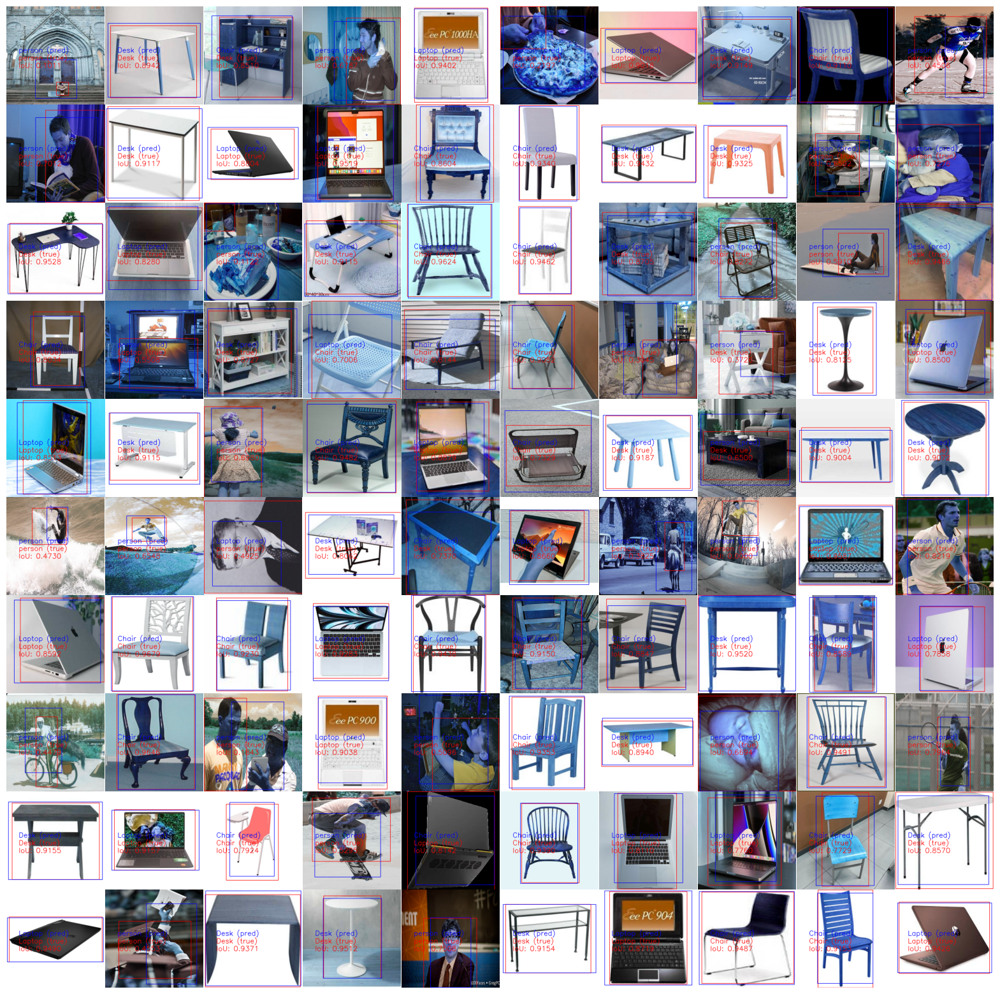

In [42]:
import matplotlib.pyplot as plt

plt.figure(figsize=(20, 20)) 
for i in range(len(images[:100])):
    ax = plt.subplot(10, 10, i + 1) 
    plt.imshow(images[i])
    plt.axis("off")

plt.subplots_adjust(wspace=0, hspace=0)
plt.show()

In [43]:
target_folder = '/kaggle/working/predict_images'
if not os.path.exists(target_folder):
    os.makedirs(target_folder)
for i, image in enumerate(images):
    image_path = os.path.join(target_folder, f'image_{i+1}.png')
    plt.imsave(image_path, image)
print(f'Đã lưu {len(images)} ảnh vào folder "{target_folder}".')

Đã lưu 439 ảnh vào folder "/kaggle/working/predict_images".
